# Notes

In [1]:
# FRI JAN 8 TODO:
# TODO: Create symlinks in this directory for the dataset so that it can be exported to other people more easily
# TODO: Clean up the names of things in this notebook
# TODO: Move all these functions to other files and create a delegation notebook to test them
# TODO: Create the standard deviation measurement from multiple translations, and create a visualization for that deviation in this notebook (with some tests, of course)
# class ViewConsistencyVarianceLoss: def __init__(self, tex_width, tex_height, num_labels, pyramid_weights=[1,1,1])
#    def forward(self, scene_uvs, scene_translations)
# TODO: Smooth moving cube blender animation for demos
# FOR EXPERIMENT: With pure simulated data, like textured cube in blender that moves around, we could use mean squared error for measuring how good each method is!
# TODO: Figure out why the table is so blurry in the naive reconstructions. Is this because the MUNIT is randomly shifting the result image? It seems to be a discerete blur, in that a few shifts are averaged together...
# NOTE: it might be beneficial to use multiple values of recovery_resolution in the view consistency loss; because that way it can criticize both high and low detail scales. This can be done with multiple ViewConsistencyLoss objects; perhaps aggregated into a MultiScaleViewConsistencyLoss(nn.Module) class. 

# Imports and Setup

#### Imports

In [2]:
from rp import *
import torch
import torch.nn as nn
import einops
import icecream

#### Config

In [3]:
%config InlineBackend.figure_format='retina'
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

#### Helper Functions

In [4]:
def display_images(images):
    if isinstance(images,torch.Tensor):
        images=as_numpy_images(images)
    display_image(tiled_images(images))

In [5]:
def as_numpy_image(image):
    if isinstance(image,np.ndarray):
        return image.copy()
    else:
        return as_numpy_images(image.unsqueeze(0))[0]

In [31]:
def resize_images(images,size,interp='bilinear'):
    return [cv_resize_image(image,size,interp) for image in images]

# Projection / Unprojection

## Prepare example data

rp.load_images: Done! Loaded 15 images in 0.296 seconds
A random cube model:


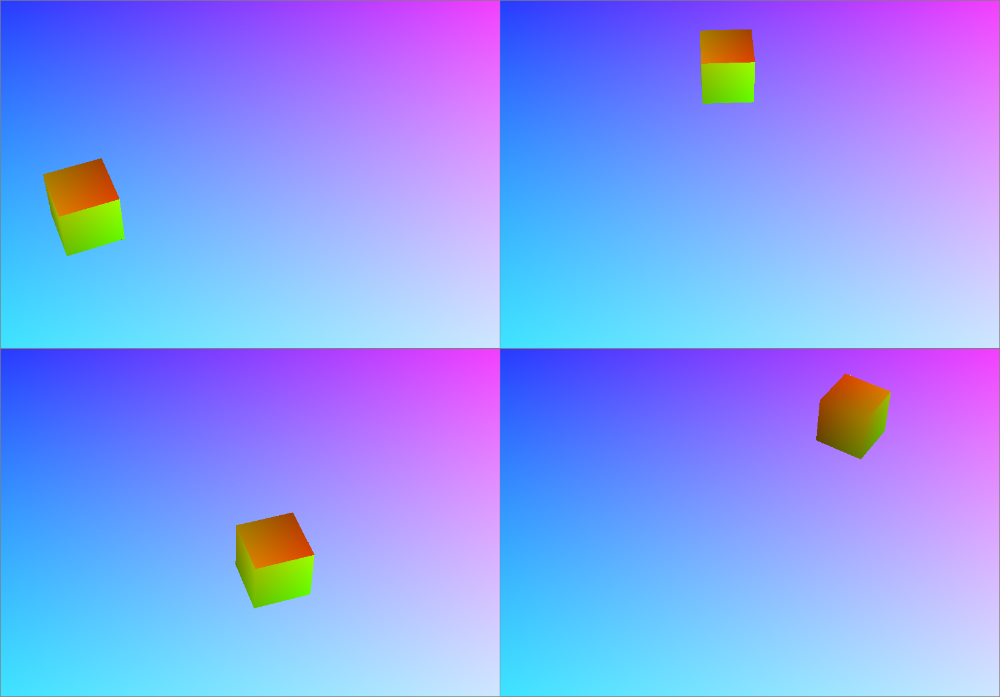

In [6]:
image_paths=get_all_files('/home/ryan/CleanCode/Datasets/diff_rendering/steve/UV_Cubes',sort_by='number')
image_paths=get_all_files('/home/ryan/CleanCode/Datasets/diff_rendering/alphabetcube_L/CroppedHalvedUV',sort_by='number')
image_paths=image_paths[:15] #For the previews, limit the number of samples. It makes the .ipynb files smaller.
cube_models=load_images(image_paths,show_progress=True,use_cache=True)
cube_models=[as_float_image(cube_model) for cube_model in cube_models]
cube_models=as_numpy_array(cube_models)
print("A random cube model:")
display_images(cube_models[:4])

Texture options:


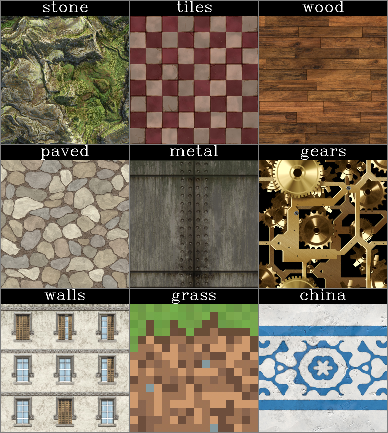

Albedo Map:


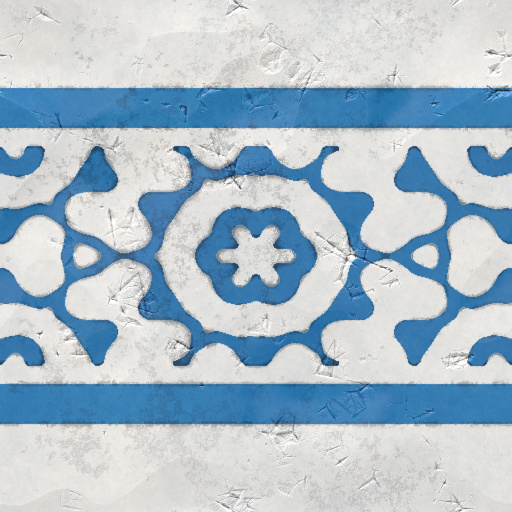

ic| albedo.shape: (512, 512, 3)


In [77]:
stone='https://www.filterforge.com/filters/12449.jpg'
tiles='https://filterforge.com/filters/10857-v4.jpg'
wood ='https://filterforge.com/filters/8892.jpg'
paved='https://filterforge.com/filters/14157.jpg'
metal='https://www.filterforge.com/filters/1375.jpg'
gears='https://www.filterforge.com/filters/8624.jpg'
walls='https://www.filterforge.com/filters/15245.jpg'
grass='https://www.filterforge.com/filters/11635.jpg'
china='https://www.filterforge.com/filters/9935.jpg'

#Go ahead and modify this notebook here: choose your favorite two textures!
#The first one goes to the cube, and the second one goes to the table.
albedo=china
second_albedo=wood

ims=load_images([stone,tiles,wood,paved,metal,gears,walls,grass,china],use_cache=True)
ims=[cv_resize_image(im,.25) for im in ims]
ims=labeled_images(ims,'stone,tiles,wood,paved,metal,gears,walls,grass,china'.split(','))
ims=tiled_images(ims)
print("Texture options:")
display_image(ims)

albedo=load_image(albedo,use_cache=True)
print("Albedo Map:")
display_image(albedo)
icecream.ic(albedo.shape)

second_albedo=load_image(second_albedo,use_cache=True)

Second Albedo Map:


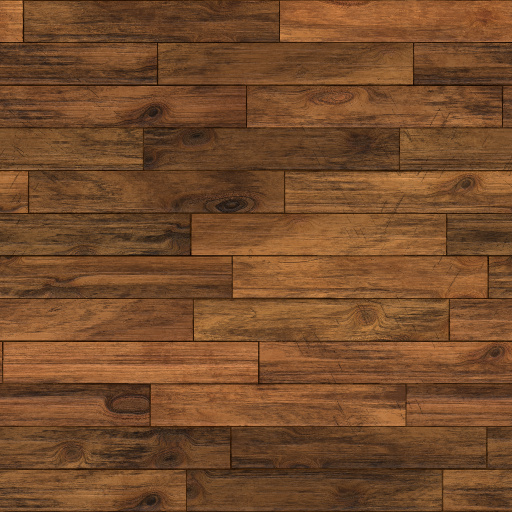

In [8]:
print("Second Albedo Map:")
display_image(second_albedo)

In [9]:
torch_cube_models=as_torch_images(cube_models)

torch_albedo       =torch.tensor(albedo       ).permute(2,0,1)/255
torch_second_albedo=torch.tensor(second_albedo).permute(2,0,1)/255

## Important Utility Functions

In [10]:
def condense_values(tensor,values):
    #Mutates the given tensor and returns it
    #   - tensor: can be either torch.Tensor or np.ndarray
    #   - values: should be a list of int
    #
    # EXAMPLES: Normal circumstances
    #     >>> condense_values(torch.Tensor([4,2,3,6,8,1]),[1,3,8])
    #    ans = tensor([4., 2., 1., 6., 2., 0.])
    #     >>> condense_values(torch.tensor([4,2,3,6,8,1]),[1,3,8])
    #    ans = tensor([4, 2, 1, 6, 2, 0])
    #     >>> condense_values(torch.tensor([4,2,3,6,8,1]),[1,2,3,4])
    #    ans = tensor([3, 1, 2, 6, 8, 0])
    #     >>> condense_values(torch.tensor([2,5,7,9]),[2,5,9])
    #    ans = tensor([0, 1, 7, 2])
    #     >>> condense_values(torch.tensor([2,5,7,9]),[2,5,7,9])
    #    ans = tensor([0, 1, 2, 3])
    #
    # EXAMPLES: When not all labels are covered
    #     >>> condense_values(torch.tensor([2,5,7,6]),[2,5,7,9])
    #    ans = tensor([0, 1, 2, 0])  # the last value is 0, because that's the default
    #
    # EXAMPLES: Works element-wise with arbitrary shapes
    #     >>> condense_values(torch.tensor([[2],[5],[7],[6]]),[2,5,7,9])
    #    ans = tensor([[0], [1], [2], [0]])
    #     >>> condense_values(torch.tensor([[2,5,7,6]]),[2,5,7,9])
    #    ans = tensor([[0, 1, 2, 0]])
    #
    # This function takes a 'tensor', and a list of numbers called 'values'
    # All elements in 'tensor' that are also in 'values' are simultaneously
    # replaced with their respective index in 'values'
    #
    # This function is used to let us specify which values of the b channel we're
    # using from the model images, so we can use multiple textures efficiently
    # See the uses of this function for a further understanding...

    values=sorted(values)
    for index,value in enumerate(values):
        tensor[tensor==value]=-index
    tensor[tensor>0]=0
    tensor=-tensor
    return tensor

In [11]:
def extract_scene_uvs_and_scene_labels(scene_images:torch.Tensor, label_values:list):
    #Takes an image obtained from an .exr file (with R,G,B) and return two torch tensors
    #It assumes all values are between [0,1] and that B encodes the label value while 
    #R,G represent the U,V values respectively
    #It also assumes that there are a maximum of 256 possible labels
    #
    #label_values is a list of label values, that will be condensed into the range [0,len(label_values)-1]

    #------- Inputs Validation -------
    
    assert len(scene_images.shape)==4, 'Images should be in the form BCHW'
    
    
    #------- Outputs Calculation -------
    
    r=scene_images[:,0,:,:]
    g=scene_images[:,1,:,:]
    b=scene_images[:,2,:,:]
    
    scene_labels=torch.floor(b*256).clamp(min=0,max=255).long()
    scene_labels=condense_values(scene_labels,label_values)
    
    u,v=r,g
    scene_uvs=torch.stack((u,v),dim=1)
    
    
    #------- Outputs Validation -------
    
    batch_size, num_channels, scene_height, scene_width = scene_images.shape
    
    assert scene_uvs   .shape == (batch_size, 2, scene_height, scene_width)
    assert scene_labels.shape == (batch_size,    scene_height, scene_width)
    
    assert scene_labels.max()<len(label_values) and scene_labels.min()>=0
    assert not scene_labels.dtype.is_floating_point
    
    return scene_uvs, scene_labels

In [12]:
scene_uvs, scene_labels = extract_scene_uvs_and_scene_labels(torch_cube_models,[0,255])

icecream.ic(torch_cube_models.shape,
            scene_uvs        .shape,
            scene_labels     .shape);

ic| torch_cube_models.shape: torch.Size([15, 4, 566, 812])
    scene_uvs        .shape: torch.Size([15, 2, 566, 812])
    scene_labels     .shape: torch.Size([15, 566, 812])


In [13]:
def colorized_scene_labels(scene_labels, label_colors):
    #Takes scene_labels, and turns each label into a certain color
    #This is useful for visualization, but might later be used for learning purposes as well
    #This is a pure function, as it does not mutate any of the inputs
    
    #------- Inputs Validation -------
    
    assert isinstance(scene_labels,torch.Tensor)
    assert isinstance(label_colors,torch.Tensor)
    
    batch_size, scene_height, scene_width = scene_labels.shape
    num_labels, num_channels              = label_colors.shape
    
    assert not scene_labels.dtype.is_floating_point
    assert     scene_labels.min()>=0 and scene_labels.max()<num_labels
    

    #------- Output Calculation -------
    
    output = einops.rearrange(scene_labels, 'BS SH SW -> (BS SH SW)')
    output = label_colors[output]
    output = einops.rearrange(output, '(BS SH SW) NC -> BS NC SH SW',
                              BS=batch_size                         ,
                              SH=scene_height                       ,
                              SW=scene_width                        )

    
    #------- Output Validation -------
    
    assert output.shape == (batch_size, num_channels, scene_height, scene_width)
    
    assert output.dtype == label_colors.dtype
    
    return output

Colorized with arbitrary colors, such as blue and pink...


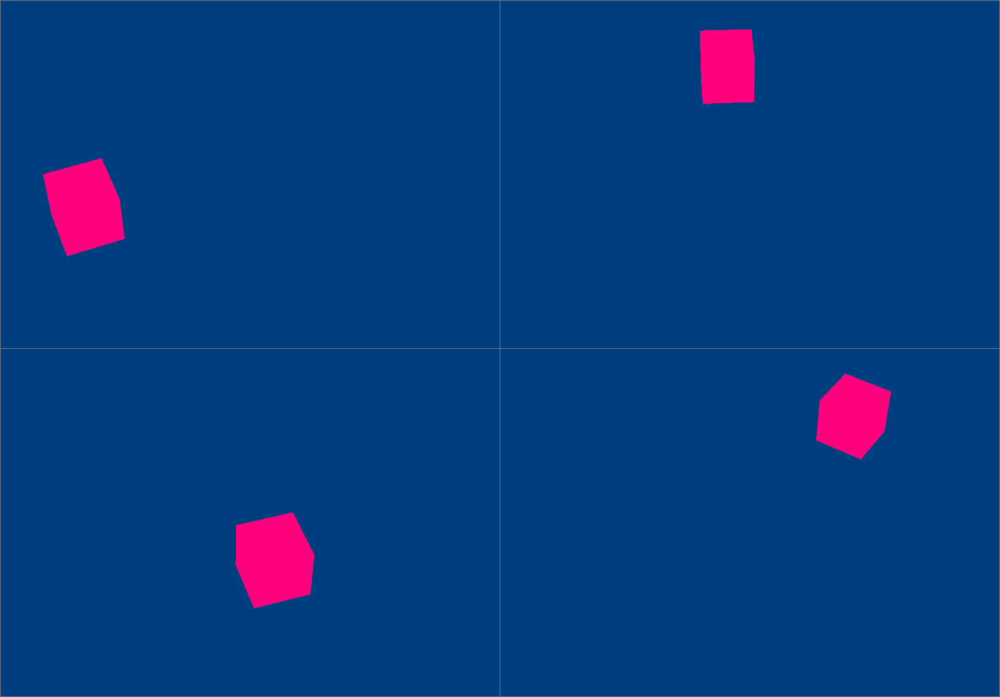

Colorized with more arbitrary colors, such as black and green...


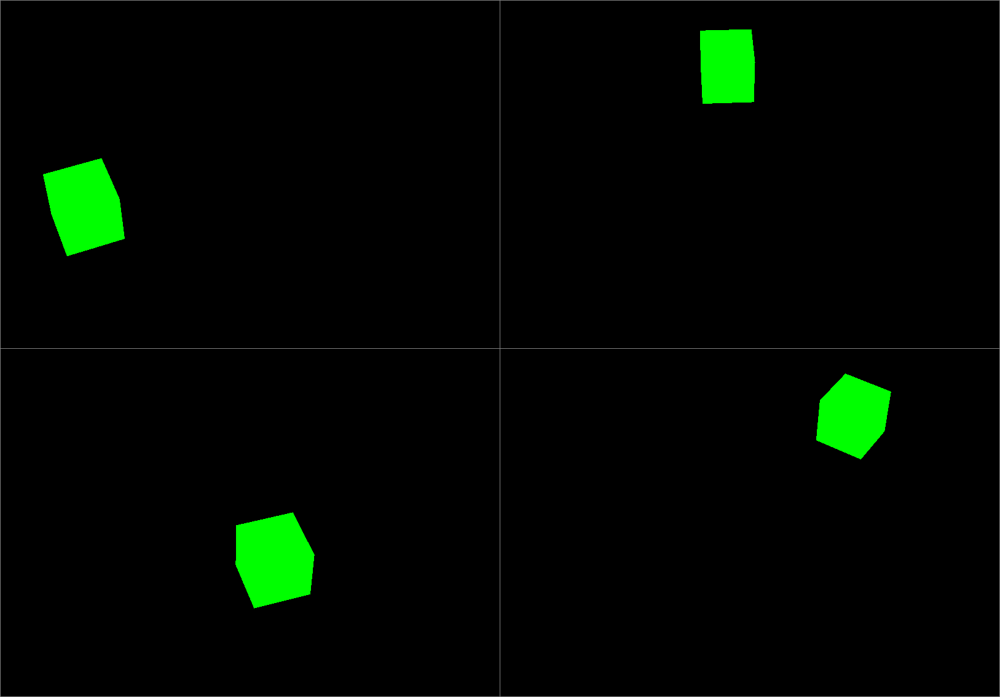

In [14]:
print("Colorized with arbitrary colors, such as blue and pink...")
colorized_labels = colorized_scene_labels(scene_labels, torch.Tensor([[1,0,.5],[0,.25,.5]]))
display_images(colorized_labels[:4])

print("Colorized with more arbitrary colors, such as black and green...")
colorized_labels = colorized_scene_labels(scene_labels, torch.Tensor([[0,1,0],[0,0,0]]))
display_images(colorized_labels[:4])

## Projection

### Functions

In [15]:
def project_textures(scene_uvs,scene_labels,textures):
    
    #TODO: Add linear interpolation like in unproject. This can be done.
    
    #------- Inputs Validation -------
    
    batch_size, scene_height, scene_width = scene_labels.shape
    assert not scene_labels.dtype.is_floating_point
    
    assert scene_uvs.shape == (batch_size, 2, scene_height, scene_width)
    
    num_labels, num_channels, texture_height, texture_width = textures.shape
    assert scene_labels.min()>=0 and scene_labels.max() < num_labels
    
    
    #------- Output Calculation -------
    
    u,v = einops.rearrange(scene_uvs, 'BS UV SH SW -> UV BS SH SW')
    u=torch.clamp(u*texture_height, min=0,max=texture_height-1).long()
    v=torch.clamp(v*texture_width , min=0,max=texture_width -1).long()
    
    assert u.shape == v.shape == (batch_size, scene_height, scene_width)
    
    textures     = einops.rearrange(textures, 'NL NC TH TW -> NL TH TW NC')
    
    scene_labels = einops.rearrange(scene_labels, 'BS SW SH -> (BS SW SH)')
    u            = einops.rearrange(u           , 'BS SW SH -> (BS SW SH)')
    v            = einops.rearrange(v           , 'BS SW SH -> (BS SW SH)')
                                    
    output = textures[scene_labels, u, v]
    output = einops.rearrange(output, '(BS SH SW) NC -> BS NC SH SW',
                              BS=batch_size                         ,
                              SH=scene_height                       ,
                              SW=scene_width                        )
    
    
    #------- Output Validation -------
    
    assert output.shape == (batch_size, num_channels, scene_height, scene_width)

    return output

### Demo 1: Albedo and Second Albedo (Arbitrary textures)

ic| textures.shape: torch.Size([2, 3, 512, 512])


Rendered images from torch: should look identical to the previous animation on every frame


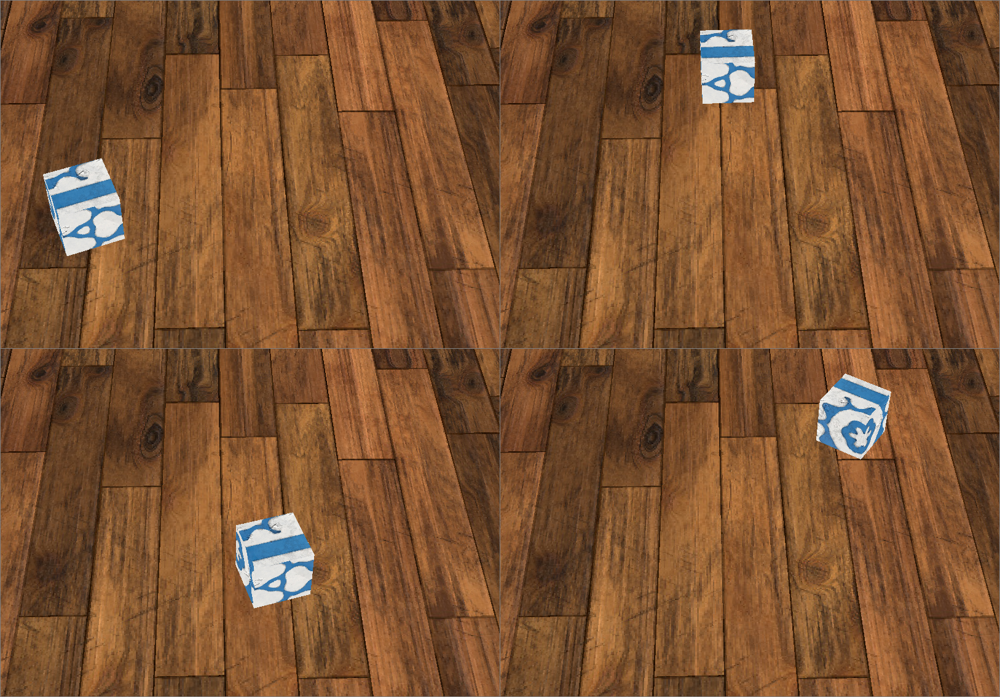

In [16]:
textures=torch.stack((torch_albedo, torch_second_albedo))

icecream.ic(textures.shape)

scene_projections = project_textures(scene_uvs, scene_labels, textures)
print("Rendered images from torch: should look identical to the previous animation on every frame")
display_images(as_numpy_images(scene_projections[:4]))

## Unprojection

### Functions

In [17]:
def calculate_subpixel_weights(x,y):
    #This function's math is explained here: 
    #   https://www.desmos.com/calculator/esool5qrrd

    Rx=x%1
    Ry=y%1
    Qx=1-Rx
    Qy=1-Ry

    A=Rx*Ry #Weight for  ceil(x), ceil(y)
    B=Rx*Qy #Weight for  ceil(x),floor(y)
    C=Qx*Qy #Weight for floor(x),floor(x)
    D=Qx*Ry #Weight for floor(x), ceil(y)

    Cx=x.ceil ().long()
    Cy=y.ceil ().long()
    Fx=x.floor().long()
    Fy=y.floor().long()

    X=torch.stack((Cx,Cx,Fx,Fx)) #All X values
    Y=torch.stack((Cy,Fy,Fy,Cy)) #All Y values
    W=torch.stack((A ,B ,C ,D )) #Weights

    return X,Y,W

In [43]:
def unproject_translations(scene_translations : torch.Tensor ,
                           scene_uvs          : torch.Tensor ,
                           scene_labels       : torch.Tensor ,
                           num_labels         : int          ,
                           output_height      : int          ,
                           output_width       : int          ,
                           version            : str='fast'   ):
    #This function is the opposite of the project_textures function
    #It's an inverse function, in a way
    #See the unproject_translations_demo.ipynb for a visual example
    #
    #This is a pure function: it doesn't mutate any of the input tensors
    #It outputs two torch.Tensor values, one of which is the mean and the other is weights

    #Ryan's personal notes:
    # TODO: Possibly change all things called 'output' to 'texture' to make it consistent naming with other functions
    # TODO: Come up with a better name for this function
    # MAYBE todo: eliminate batch size, because we're going to be doing this once for every image anyway...
    # Batch size is technically unnesecary...but it might be nice to keep it, idk...it combines confidence of multiple scenes very nicely...(ok, I'll keep batch size)
    # TODO: Perhaps keep track of output_sum_of_squares as well (another vector) so that we could output the variance at the same time as we output the sum?
    # The alternative is running this funtion multiple times, and comparing the texture outputs...which is also a totally valid approach. It doesn't need BS to do that though...

    #------- Input Validation -------
    
    #Validate scene_uvs
    batch_size, two, scene_height, scene_width = scene_uvs.shape
    assert two == 2, "scene_uvs should have exactly two channels"
    assert scene_uvs.min() >= 0 and scene_uvs.max() <=1, 'All u,v values should be between 0 and 1'

    #Validate scene_labels
    assert     scene_labels.shape == (batch_size, scene_height, scene_width)
    assert     scene_labels.max() < num_labels     , "The scene_labels includes labels that can't be included in the output!"
    assert not scene_labels.dtype.is_floating_point, "scene_labels should be an integer type, because it is used as an index"

    #Validate scene_translations
    num_channels = scene_translations.shape[1]
    assert scene_translations.shape == (batch_size, num_channels, scene_height, scene_width)

    #Validate integer arguments
    assert num_labels    >= 1 and isinstance(num_labels   ,int)
    assert output_height >= 1 and isinstance(output_height,int)
    assert output_width  >= 1 and isinstance(output_width ,int)

    #Validate version
    assert version in ['fast','slow']


    #------- Outputs Calculation -------

    #This 'Outputs Calculation' section is acronym-heavy.
    #Acronym Key:
    #  - BS = batch_size
    #  - SH,SW,OH,OW = scene_height,scene_width,output_height,output_width
    #  - NC,NL = num_channels,num_labels
    #  - ABCD = 4: it refers to the four A,B,C,D values in the function calculate_subpixel_weights
    #  - w = weights
    #  - t = weighted scene_translations, which are summed together to get the output
    NC = num_channels
    NL = num_labels
    OH = output_height
    OW = output_width

    #Populate the outputs
    u,v = einops.rearrange(scene_uvs.clone(),'BS NC SH SW -> NC BS SH SW')
    assert u.shape == v.shape == (batch_size, scene_height, scene_width)
    
    #Convert u,v from range [0,1),[0,1) to [0,output_height),[0,output_width)
    u *= output_height#-1
    v *= output_width #-1 To subtract 1 or not...depends on the projection function, and whether not u=.999999 means a bottom pixel

    #Calculate the subpixel weights w, and make u,v integers
    u,v,w = calculate_subpixel_weights(u,v)
    assert u.shape == v.shape == w.shape == (4, batch_size, scene_height, scene_width)
    assert not u.dtype.is_floating_point and not v.dtype.is_floating_point

    #The calculate_subpixel_weights is likely to reference indices one index outside of the image.
    #Correct this by pushing those indices back into the image again.
    u=u.clamp(0,output_height-1)
    v=v.clamp(0,output_width -1)
    l = scene_labels

    t = scene_translations

    #Reshape stuff
    u = einops.rearrange(u, 'ABCD BS    SH SW -> (BS SH SW ABCD)   '       )
    v = einops.rearrange(v, 'ABCD BS    SH SW -> (BS SH SW ABCD)   '       )
    w = einops.rearrange(w, 'ABCD BS    SH SW -> (BS SH SW ABCD)   '       )
    l = einops.repeat   (l, '     BS    SH SW -> (BS SH SW ABCD)   ',ABCD=4)
    t = einops.repeat   (t, '     BS NC SH SW -> (BS SH SW ABCD) NC',ABCD=4)

    #Create empty output tensors
    output_device = scene_translations.device
    output_weight = torch.zeros((num_labels, output_height, output_width              ), device = output_device)
    output_sum    = torch.zeros((num_labels, output_height, output_width, num_channels), device = output_device)

    assert len(t) == len(u) == len(v) == len(w) == len(l)

    if version=='fast':
        #THE FAST VERSION:
        #This version is very fast, but a bit cryptic
        #
        #Summary of this version using imprecise notation:        
        #  #What I'd like to write, but can't:
        #     output_sum   [l, u, v] += t 
        #     output_weight[l, u, v] += w 
        #     # This doesn't accumulate properly when we have duplicate l,u,v's
        #  #Splitting it into R,G,B:
        #     output_sum   [l, u, v, 0] += t[:,0] 
        #     output_sum   [l, u, v, 1] += t[:,1] 
        #     output_sum   [l, u, v, 2] += t[:,2] 
        #     output_weight[l, u, v] += w 

        output_sum    = output_sum   .view(NL*OH*OW*NC)
        output_weight = output_weight.view(NL*OH*OW   )

        for i in range(NC):
            output_sum.index_add_(0, (l*OH*OW*NC + u*OW*NC + v*NC + i), t[:,i]*w)
        output_weight.index_add_ (0, (l*OH*OW    + u*OW    + v       ),        w)
        
        output_sum    = output_sum   .view(NL,OH,OW,NC)
        output_weight = output_weight.view(NL,OH,OW   )

    if version=='slow':
        #THE SUPER-SLOW VERSION:    
        # This version is very slow, but much easier to understand. 
        # It gives exactly the same results as when version=='fast'
        # This version was used to verify the correctness of the 'fast' version
        # In my experiments, version=='slow' took 181 seconds whereas 'fast' took 0.003057 seconds. That's a 59208x speedup!
        # Note: the first call of the 'fast' version often takes longer than subsequent calls; going from .1 seconds to .003
        for l_,u_,v_,t_,w_ in zip(l,u,v,t,w):
            output_sum   [l_,u_,v_]+=w_*t_
            output_weight[l_,u_,v_]+=w_
        
    output_sum = einops.rearrange(output_sum, 'NL OH OW NC -> NL NC OH OW')
    assert output_sum.shape == (num_labels, num_channels, output_height, output_width)
    
    denominator = output_weight.clone()
    denominator[denominator == 0] = 1  # Avoid division by zero errors
    denominator = denominator[:, None, :, :]  # Make this tensor fit

    output_mean = output_sum/denominator


    #------- Outputs Validation -------

    assert output_mean  .shape == (num_labels, num_channels, output_height, output_width)
    assert output_weight.shape == (num_labels,               output_height, output_width)
    
    return output_mean, output_weight

In [60]:
def unproject_translations_individually(scene_translations : torch.Tensor ,
                                        scene_uvs          : torch.Tensor ,
                                        scene_labels       : torch.Tensor ,
                                        num_labels         : int          ,
                                        output_height      : int          ,
                                        output_width       : int          ,
                                        version            : str='fast'   ):
    #Takes in and spits out the same tensor shapes as unproject_translations(...), except BS is at the beginning
    #That is to say, this outputs (textures,weights) aka (BS NL NC TH TW,  BS NC TH TW) tensors
    #(See the unproject_translations(...) function to see what those two-letter dimension acronyms mean)
    #However, this version applies unproject_translations(...) to each element of the batch individually
    
    output_textures=[]
    output_weights =[]
    
    for scene_translation, scene_uv, scene_label in zip(scene_translations, scene_uvs, scene_labels):
    
        texture, weight = unproject_translations(scene_translation[None],
                                                 scene_uv         [None],
                                                 scene_label      [None],
                                                 num_labels             ,
                                                 output_height          ,
                                                 output_width           )
        output_textures.append(texture)
        output_weights .append(weight )
        
    output_textures=torch.stack(output_textures,dim=0)
    output_weights =torch.stack(output_weights ,dim=0)
    
    return output_textures, output_weights

### Demo 1: Albedo and Second Albedo

In [20]:
num_labels=len(textures)
recovery_resolution=1024
# recovery_resolution=512
# recovery_resolution=256
recovered_textures, _ = unproject_translations(scene_projections                ,
                                               scene_uvs                        ,
                                               scene_labels                     ,
                                               num_labels                       ,
                                               output_height=recovery_resolution,
                                               output_width =recovery_resolution)

Unprojection mean:


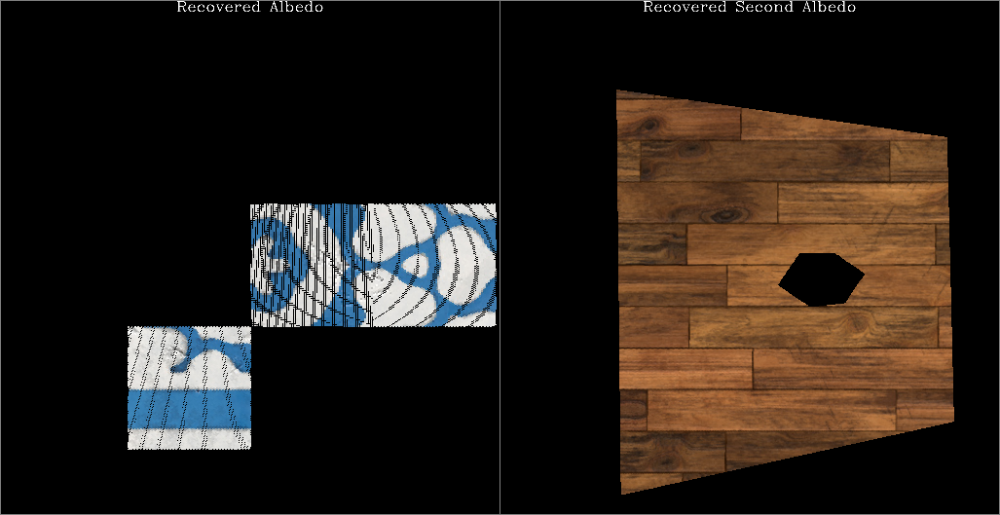

Unprojection weights:


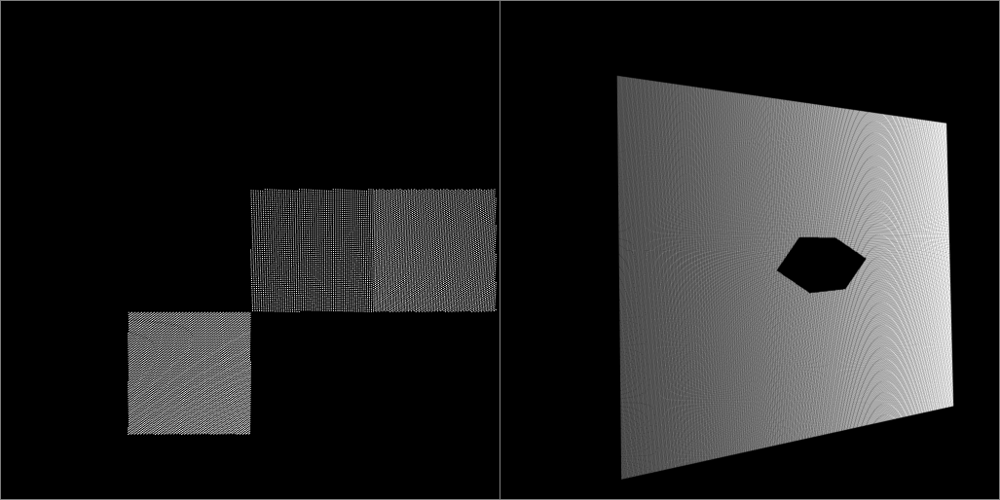

In [25]:
print("Unprojection mean:")
display_images(recovered_textures)
w=torch.stack((_,_,_),dim=1)
w=w/w.max(dim=1,keepdim=True)[0].max(dim=2,keepdim=True)[0].max(dim=3,keepdim=True)[0]
print("Unprojection weights:")
display_images(w)

In [33]:
frames=[]

for scene_uv, scene_label, scene_projection, cube_model in zip(scene_uvs, scene_labels, scene_projections, cube_models):
    # recovery_resolution=1024
    recovery_resolution=512
    # recovery_resolution=256
    recovered_textures, _ = unproject_translations(scene_projection[None]           ,
                                                   scene_uv        [None]           ,
                                                   scene_label     [None]           ,
                                                   num_labels                       ,
                                                   output_height=recovery_resolution,
                                                   output_width =recovery_resolution)
    
    scene_projection   = as_numpy_image (scene_projection  )
    recovered_textures = as_numpy_images(recovered_textures)
    
    scene_width = get_image_width(scene_projection)
    assert get_image_width(cube_model) == scene_width
    
    scene_stuff = [scene_projection, cube_model]
    scene_stuff = resize_images (scene_stuff, recovery_resolution/scene_width          )
    scene_stuff = labeled_images(scene_stuff, ['Scene Projection', 'UV Map and Labels'])
    
    recovered_textures = labeled_images(recovered_textures, ['Recovered Albedo','Recovered Second Albedo'])
    
    frame = grid_concatenated_images([recovered_textures, scene_stuff])
    
    frames.append(frame)

display_image_slideshow(frames)

Once 
 
 Loop 
 
 Reflect

### Demo 2: Unprojecting Naive Image Translations

Naive UV/Translations:


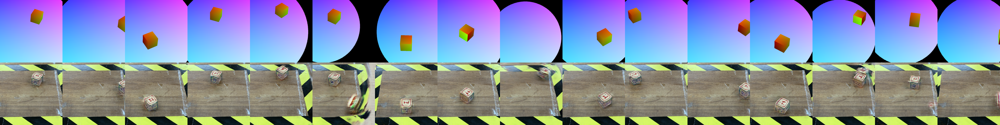

ic| naive_data.min(): 0.0
    naive_data.max(): 1.0
    naive_scene_uv_and_labels.shape: (16, 256, 256, 3)
    naive_scene_tranlations.shape: (16, 256, 256, 3)


Four random image translation results, zoomed in


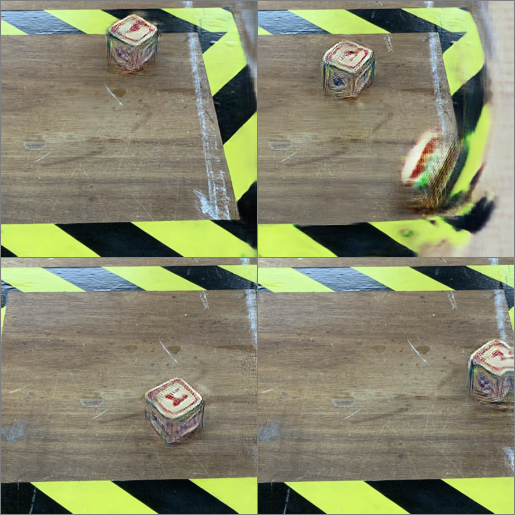

In [95]:
naive_data=load_image('./Assets/naive_translation_samples.png')
naive_data=as_rgb_image(as_float_image(naive_data))
# Note: This naiva data is loaded from a png with 1 byte per color channel,
# so it's UV values are rounded into 256 positions 
# Note: There are only 16 samples. That's ok - this isn't a dataset. It's the results of an image-to-image
# translation algorithm, that's naive to the semantics of what the U,V values mean. In other words, that
# simple image-to-image translation algorithm is naive to the 3d information about the cube and table.

print('Naive UV/Translations:')
display_image(naive_data)

naive_scene_uv_and_labels, naive_scene_tranlations = split_tensor_into_regions(naive_data, 2 , 16, flat=False)

icecream.ic(naive_data.min(), naive_data.max(), naive_scene_uv_and_labels.shape, naive_scene_tranlations.shape);

print("Four random image translation results, zoomed in")
display_images(random_batch(naive_scene_tranlations,4))

In [35]:
torch_naive_scene_uv_and_labels = as_torch_images(naive_scene_uv_and_labels)
torch_naive_scene_tranlations   = as_torch_images(naive_scene_tranlations   )
torch_naive_scene_uvs, torch_naive_scene_labels = extract_scene_uvs_and_scene_labels(torch_naive_scene_uv_and_labels,
                                                                                     label_values=[0,255]           )

icecream.ic(torch_naive_scene_tranlations.shape,torch_naive_scene_tranlations.min(),torch_naive_scene_tranlations.max(),
            torch_naive_scene_uvs        .shape,torch_naive_scene_uvs        .min(),torch_naive_scene_uvs        .max(),
            torch_naive_scene_labels     .shape,torch_naive_scene_labels     .min(),torch_naive_scene_labels     .max());

ic| torch_naive_scene_tranlations.shape: torch.Size([16, 3, 256, 256])
    torch_naive_scene_tranlations.min(): tensor(0.0039)
    torch_naive_scene_tranlations.max(): tensor(0.9961)
    torch_naive_scene_uvs        .shape: torch.Size([16, 2, 256, 256])
    torch_naive_scene_uvs        .min(): tensor(0.)
    torch_naive_scene_uvs        .max(): tensor(0.9843)
    torch_naive_scene_labels     .shape: torch.Size([16, 256, 256])
    torch_naive_scene_labels     .min(): tensor(0)
    torch_naive_scene_labels     .max(): tensor(1)


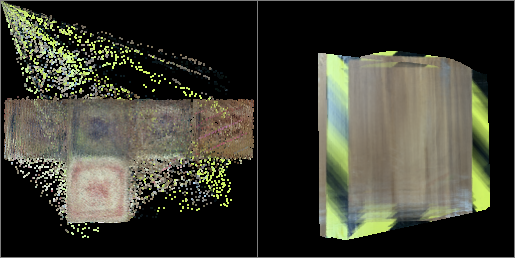

In [36]:
recovery_resolution=1024  #Try out different recovery resolutions! You'll see why it's sometimes best to leave it small.
recovery_resolution=512
recovery_resolution=256
number_of_naive_samples=1 #As this number increases, it will become blurrier but get more coverage
number_of_naive_samples=4 
number_of_naive_samples=16 
recovered_textures, recovered_weights = unproject_translations(torch_naive_scene_tranlations[:number_of_naive_samples],
                                                               torch_naive_scene_uvs        [:number_of_naive_samples],
                                                               torch_naive_scene_labels     [:number_of_naive_samples],
                                                               num_labels   =2,
                                                               output_height=recovery_resolution,
                                                               output_width =recovery_resolution)

display_images(recovered_textures)

**Speculation Note: "Blurryness"** 

A question: Why are the textures so blurry? My guess: Look a bit closer on the floor texture. There's absolutely no reason this should be blurry - the image translation algorithm gets the table right almost perfectly (because it's a non-moving object that's in exactly the same place in every image). Take a look at naive_data, and you'll see the table is a lot more crisp. In particular, however, it seems that it's been shifted only up and down: a vertical blur. First of all, this blur is becasue of the averaging operation in the unprojection function: it aggregates all textures extracted from all scenes. This means that some of the tables appeared shifted left and right randomly in the image translations relative to the UV inputs. 

I suspect this has something to do with the data augmentation used during the naive image translation training. I'll have to look into this more later.

Naive reprojections:


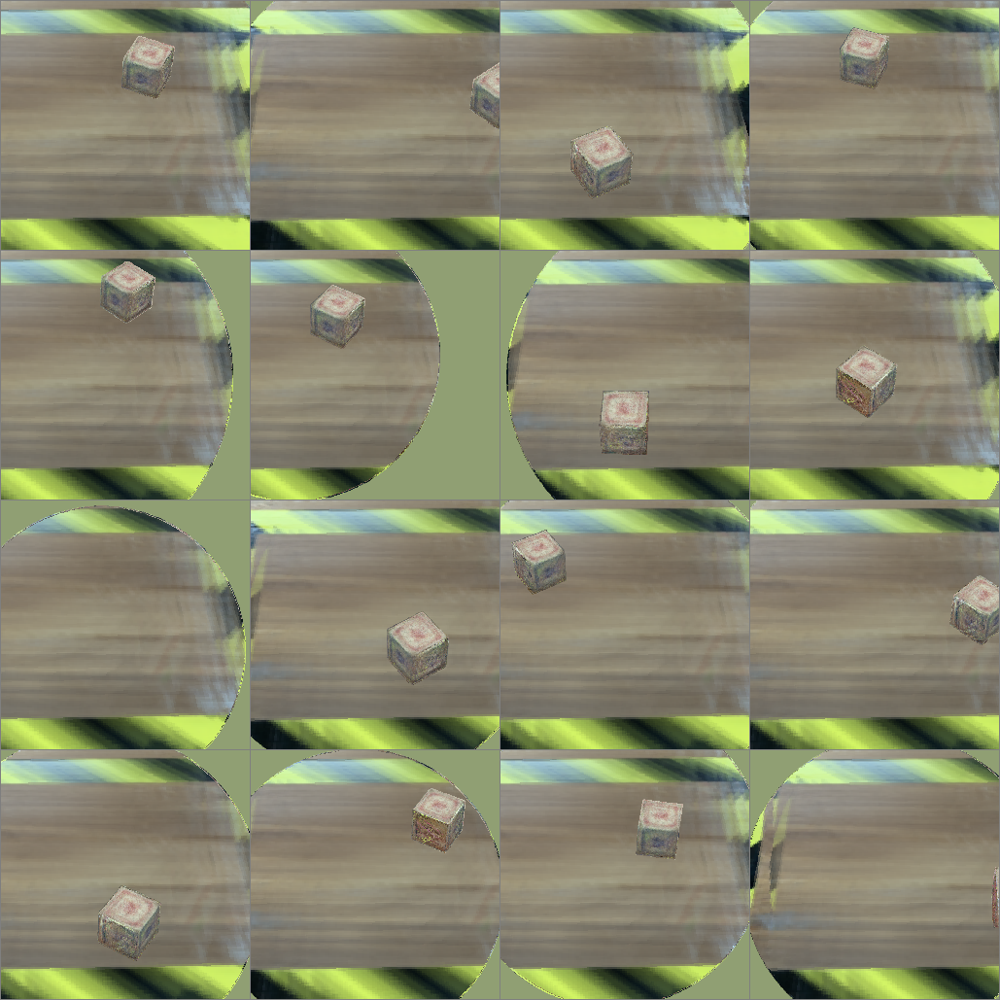

In [37]:
naive_reprojections=project_textures(torch_naive_scene_uvs, torch_naive_scene_labels, recovered_textures)

naive_reprojections=as_numpy_images(naive_reprojections)

print("Naive reprojections:")
display_images(naive_reprojections)

Naive reprojections:


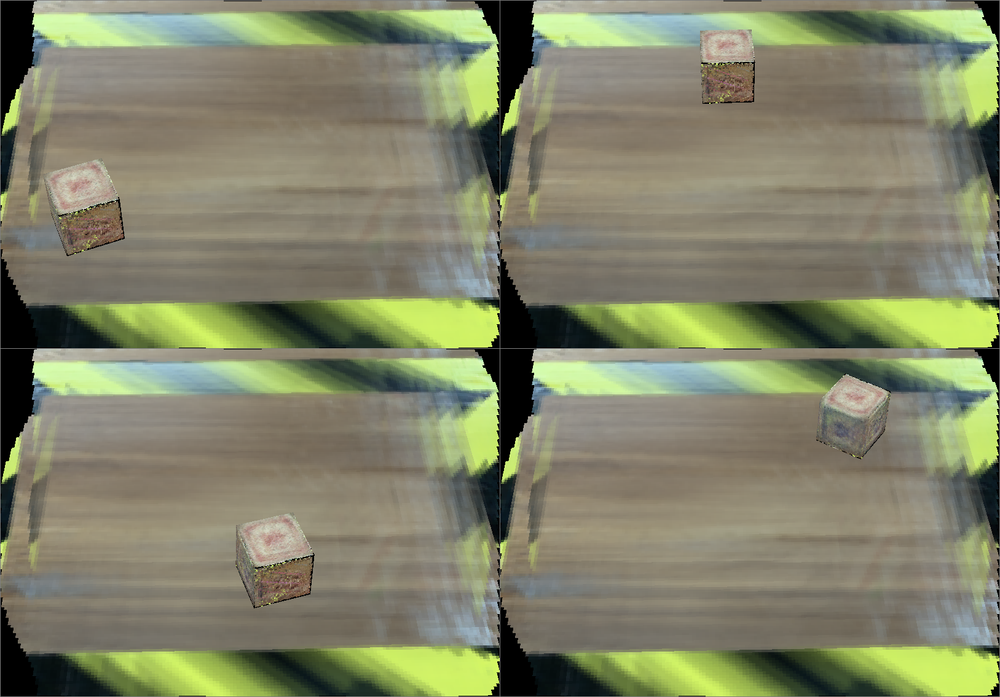

Once 
 
 Loop 
 
 Reflect

In [40]:
naive_to_big_reprojections=project_textures(scene_uvs, scene_labels, recovered_textures)
naive_to_big_reprojections=as_numpy_images(naive_to_big_reprojections)

print("Naive Reprojections:")
display_images(naive_to_big_reprojections[:4])
display_image_slideshow(resize_images(naive_to_big_reprojections,1/2))

### Demo 3: Individual Unprojections

In [56]:
recovery_resolution = 256
recovered_texture_packs, recovered_weight_packs = unproject_translations_individually(torch_naive_scene_tranlations    ,
                                                                                      torch_naive_scene_uvs            ,
                                                                                      torch_naive_scene_labels         ,
                                                                                      num_labels   =2                  ,
                                                                                      output_height=recovery_resolution,
                                                                                      output_width =recovery_resolution)

Individually recovered cube textures:


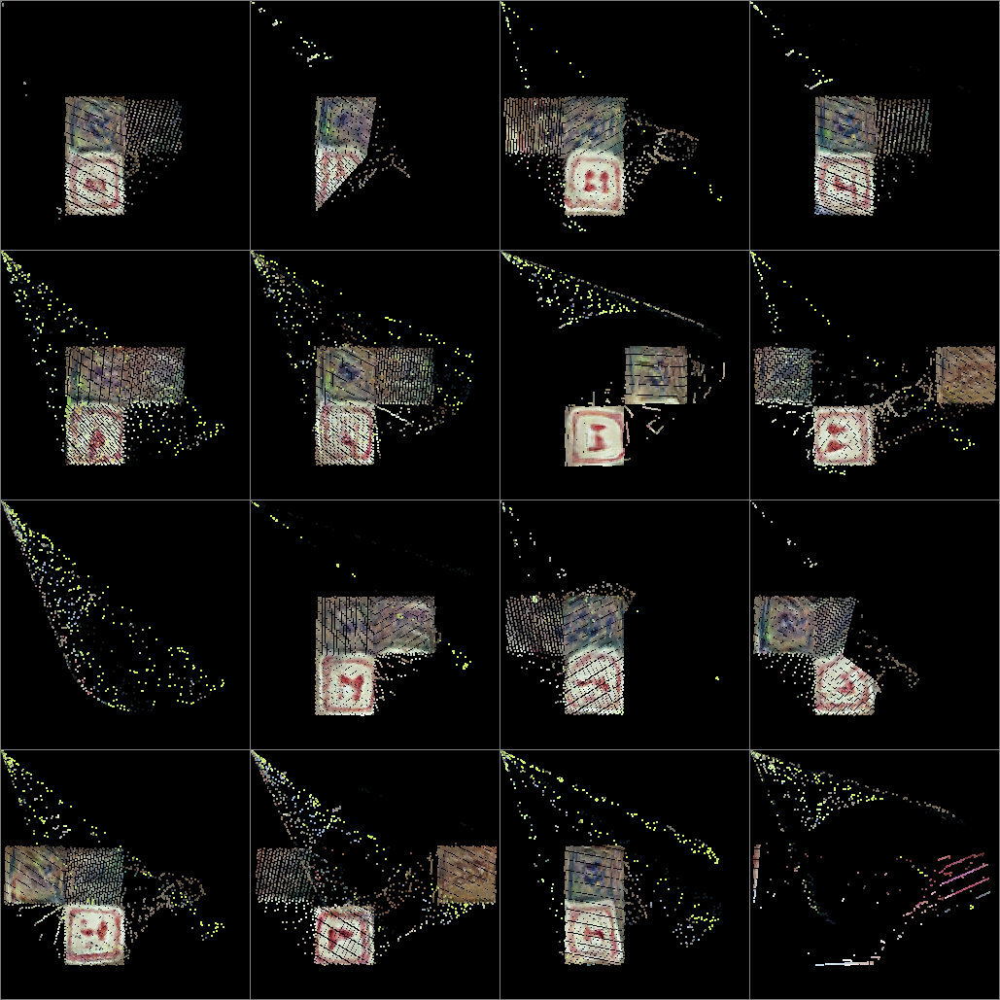

Individually recovered table textures:


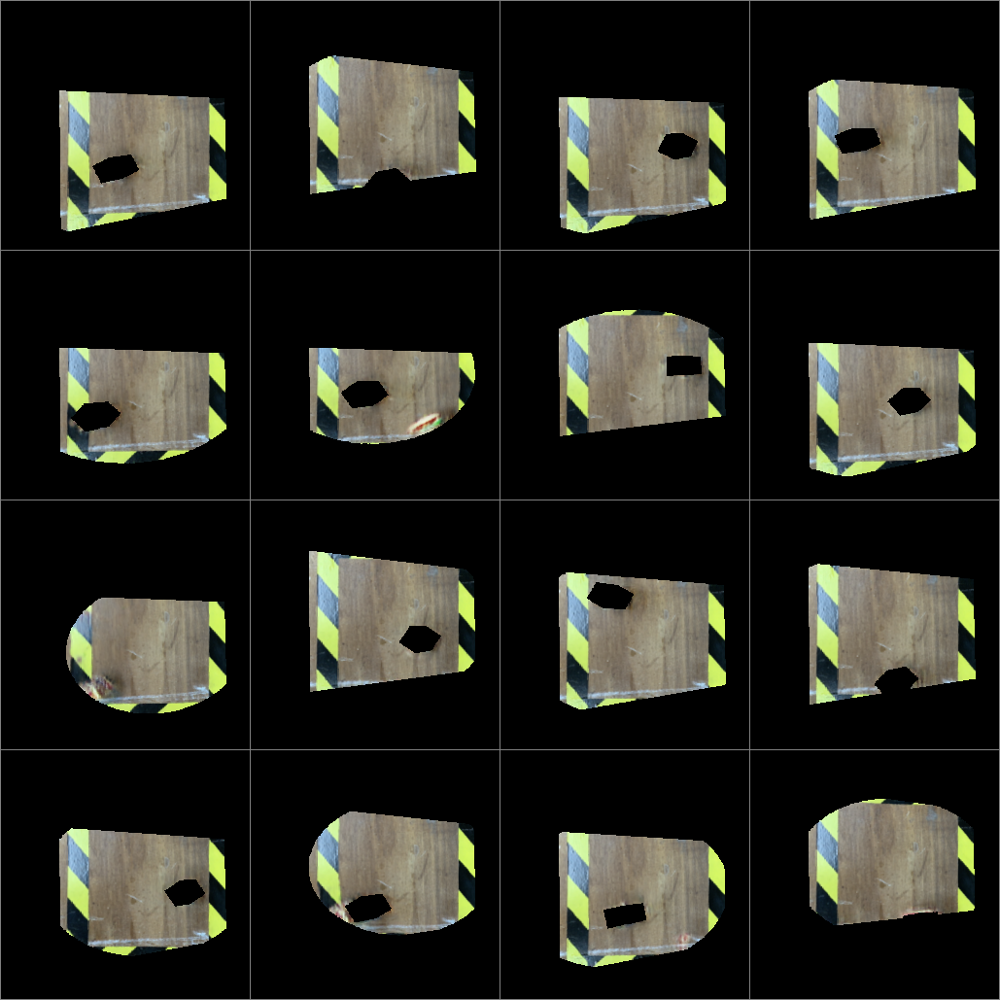

In [79]:
print("Individually recovered cube textures:")
display_images(recovered_texture_packs[:,0])

print("Individually recovered table textures:")
display_images(recovered_texture_packs[:,1])

Some individually recovered textures, along with their source images


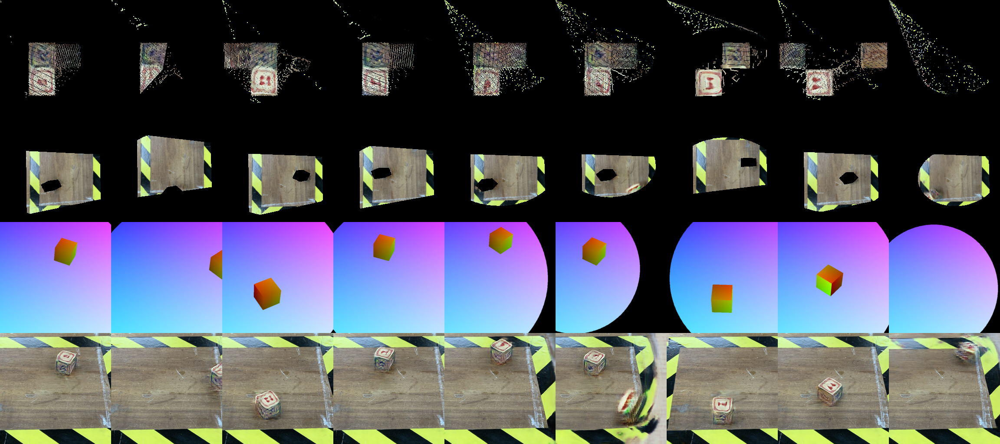

In [73]:
print("Some individually recovered textures, along with their source images")

num_display_samples=9

display_image(grid_concatenated_images([as_numpy_images(recovered_texture_packs[:num_display_samples,0]),
                                        as_numpy_images(recovered_texture_packs[:num_display_samples,1]),
                                        naive_scene_uv_and_labels              [:num_display_samples  ] ,
                                        naive_scene_tranlations                [:num_display_samples  ] ]))

**Speculation Note: "Streaks"**

The strange streaks appearing from the top left corner are a result of the smooth edges around the black circles in the UV maps, and the other distortions are from the cube/table boundaries in the UV parts of the naive_data images. Because the edges aren't crisp, there's a blend between the UV's of the table and the cube, resulting in UV values that don't actually exist, and don't correspond to any object. Because they're just on the edges of objects, I suspect they'll have minimal impact on the total image texture. 

In addition, you might ask: "Ok, that makes sense, but the blue values should also be interpolated; resulting in a label value that also doesn't exist. Shouldn't that mean it skips those points?" And the answer right now, unfortunately, is no. That might be fixed in the future, but for now I believe that this won't happen in the actual use-case this unprojector will be used in: as a data preprocessor for the image-to-image translation algorithm. Right now, the defualt label when we don't know what label to give is 0. That's why all the artifacts are in the left texture image (texture number zero).

This all can (and will) be fixed by using better UV maps: crisp ones with no antialiasing. However, for the purposes of this tutorial, it doesn't really matter.

**Note: "Non-Blurryness"**

This note is to help with a previous speculation note, "Blurryness". Note how since now we're only recovering textures from an individual scene, the table is no longer blurry. The table only becomes blurry when we're recovering a single texture from multiple scenes at once. Also notice how the cube's texture isn't as blurry.

# View Consistency Loss

In [80]:
### Weighted Mean/Variance

In [81]:
def weighted_mean(images,weights):
    #Takes BCHW images and BHW weights and returns a pixel-wise CHW average
    
    assert len(images.shape)==4 and len(weights.shape)==3
    
    numerator   = (images*weights[:,None]).sum(dim=0) # CHW tensor
    denominator = weights.sum(dim=0)[None]            # 1HW tensor
    
    denominator[denominator==0] = 1 #Get rid of 0's in denominator
    # When a particular pixel has 0 weight in any image, the output pixel is black
    
    return numerator/denominator
    
def weighted_variance(images,weights):
    #Takes BCHW images and BHW weights and returns a pixel-wise CHW variances
    #Variance is the average squared distance to the mean
    
    mean = weighted_mean(images, weights) #  CHW tensor
    mean = mean[None]                     # 1CHW tensor
    diff = images - mean                  # BCHW tensor
    squared_diff = diff ** 2              # BCHW tensor
    
    numerator   = (squared_diff*weights[:,None]).sum(dim=0) # CHW tensor
    denominator = weights.sum(dim=0)[None]                  # 1HW tensor
    
    denominator[denominator==0] = 1 #Get rid of 0's in denominator
    
    return numerator/denominator

Variance of the individually recovered cube textures:


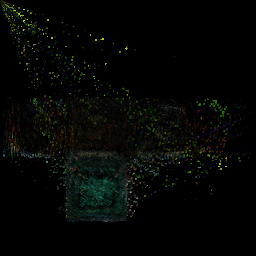

Variance of the individually recovered table textures:


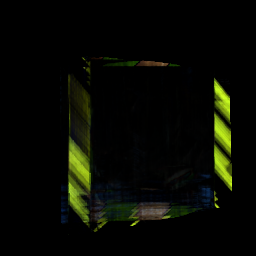

In [91]:
print("Variance of the individually recovered cube textures:")
display_image(full_range(as_numpy_image(weighted_variance(recovered_texture_packs[:,0],recovered_weight_packs[:,0]))))

print("Variance of the individually recovered table textures:")
display_image(full_range(as_numpy_image(weighted_variance(recovered_texture_packs[:,1],recovered_weight_packs[:,1]))))

Here, we're displaying the variance of the first two sets of images displayed in Unprojection Demo 3. Note how there's a lot of disagreement about where the striped tape should be (which is why it's so blurry). Because of this, those areas have a high variance. 

This variance will be used as a *"View Consistency Loss"*: the neural network and neural texture will be learned to try and minimize this view inconsistency (measured by variance in recovered textures).

Also, note that I'm using the variance instead of the standard deviation. That might change in the future; it really depends on what kind of results I get. I'm note sure what the best loss is - but I suspect variance is kinda like MSE from the mean, so maybe it will make a good loss function. I'll probably end up trying both losses though.

For comparison, I'll show what the standard deviation looks like below:


Standard Deviation of the individually recovered cube textures:


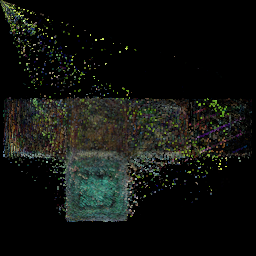

Standard Deviation of the individually recovered table textures:


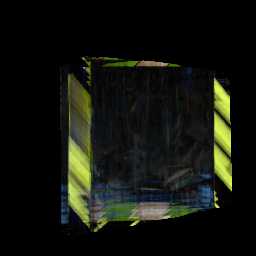

In [96]:
print("Standard Deviation of the individually recovered cube textures:")
display_image(full_range(as_numpy_image(weighted_variance(recovered_texture_packs[:,0],recovered_weight_packs[:,0])**.5)))

print("Standard Deviation of the individually recovered table textures:")
display_image(full_range(as_numpy_image(weighted_variance(recovered_texture_packs[:,1],recovered_weight_packs[:,1])**.5)))

In [84]:
# class ViewConsistencyLoss(nn.Module):
#     def __init__(self, tex_width, tex_height, num_labels)